# Novelty detection

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.covariance import EllipticEnvelope
outliers_fraction = 0.01

In [2]:
df = pd.read_csv("ambient_temperature_system_failure.csv")

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7267 entries, 0 to 7266
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   timestamp  7267 non-null   object 
 1   value      7267 non-null   float64
dtypes: float64(1), object(1)
memory usage: 113.7+ KB


In [4]:
df.head(5)

,timestamp,value
0,2013-07-04 00:00:00,69.880835
1,2013-07-04 01:00:00,71.220227
2,2013-07-04 02:00:00,70.877805
3,2013-07-04 03:00:00,68.959400
4,2013-07-04 04:00:00,69.283551


In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
value,7267.0,71.242433,4.247509,57.458406,68.369411,71.858493,74.430958,86.223213


In [6]:
# Feature extraction for timestamp value
df['timestamp'] = df['timestamp'].astype('datetime64')
df['months'] = df['timestamp'].dt.month
df['hours'] = df['timestamp'].dt.hour
df['light'] = ((df['hours'] >= 7) & (df['hours'] <= 20)).astype(int)
df['time'] = (df['timestamp'].astype(np.int64)/100000000000).astype(np.int64)

In [7]:
# Create new feature for that day is weekday or not
# 0-6 : Monday - Sunday
df['dayOfWeek'] = df['timestamp'].dt.dayofweek
df['weekDay'] = (df['dayOfWeek'] < 5).astype(int)

In [8]:
# Simple formula to create categorical value from weekday and daylight status
df["parts"] = df["weekDay"]*2 + df["light"]
# 0 * 2 + 0 = 0 -> weekend night
# 0 * 2 + 1 = 1 -> weekend daylight
# 1 * 2 + 0 = 2 -> weekday night
# 1 * 2 + 1 = 3 -> weekday daylight
df["parts"].value_counts()

3    3064
2    2179
1    1176
0     848
Name: parts, dtype: int64

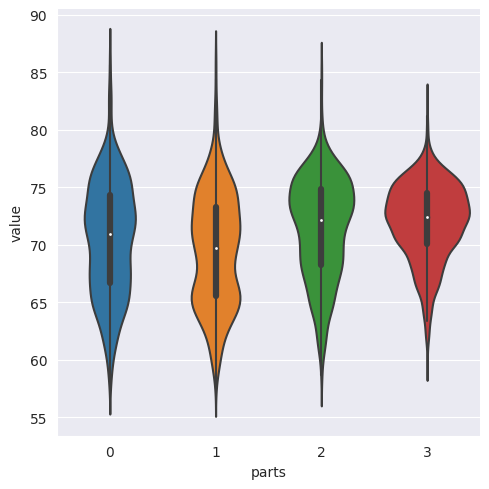

In [9]:
sns.catplot(x= "parts", y = "value", kind = "violin", data = df);

## Gaussian Distribution

In [10]:
# Create seperate dataframes from categories
df_cat0 = df.loc[df['parts'] == 0, 'value']
df_cat1 = df.loc[df['parts'] == 1, 'value']
df_cat2 = df.loc[df['parts'] == 2, 'value']
df_cat3 = df.loc[df['parts'] == 3, 'value']

In [11]:
# Part 0
envelope =  EllipticEnvelope(contamination = outliers_fraction) 
X_train = df_cat0.values.reshape(-1,1)
envelope.fit(X_train)
df_cat0 = pd.DataFrame(df_cat0)
df_cat0['anomaly'] = envelope.predict(X_train)

In [12]:
# Part 1
envelope =  EllipticEnvelope(contamination = outliers_fraction) 
X_train = df_cat1.values.reshape(-1,1)
envelope.fit(X_train)
df_cat1 = pd.DataFrame(df_cat1)
df_cat1['anomaly'] = envelope.predict(X_train)

In [13]:
# Part 2
envelope =  EllipticEnvelope(contamination = outliers_fraction) 
X_train = df_cat2.values.reshape(-1,1)
envelope.fit(X_train)
df_cat2 = pd.DataFrame(df_cat2)
df_cat2['anomaly'] = envelope.predict(X_train)

In [14]:
# Part 3
envelope =  EllipticEnvelope(contamination = outliers_fraction) 
X_train = df_cat3.values.reshape(-1,1)
envelope.fit(X_train)
df_cat3 = pd.DataFrame(df_cat3)
df_cat3['anomaly'] = envelope.predict(X_train)

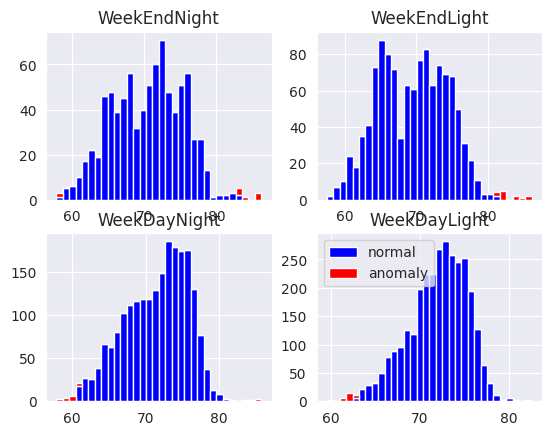

In [15]:
# Plot anomaly and normal values

a0 = df_cat0.loc[df_cat0['anomaly'] == 1, 'value']
b0 = df_cat0.loc[df_cat0['anomaly'] == -1, 'value']

a1 = df_cat1.loc[df_cat1['anomaly'] == 1, 'value']
b1 = df_cat1.loc[df_cat1['anomaly'] == -1, 'value']

a2 = df_cat2.loc[df_cat2['anomaly'] == 1, 'value']
b2 = df_cat2.loc[df_cat2['anomaly'] == -1, 'value']

a3 = df_cat3.loc[df_cat3['anomaly'] == 1, 'value']
b3 = df_cat3.loc[df_cat3['anomaly'] == -1, 'value']

fig, f = plt.subplots(2,2)

f[0,0].hist([a0,b0], bins=32, stacked=True, color=['blue', 'red'], label=['normal', 'anomaly'])
f[0,1].hist([a1,b1], bins=32, stacked=True, color=['blue', 'red'], label=['normal', 'anomaly'])
f[1,0].hist([a2,b2], bins=32, stacked=True, color=['blue', 'red'], label=['normal', 'anomaly'])
f[1,1].hist([a3,b3], bins=32, stacked=True, color=['blue', 'red'], label=['normal', 'anomaly'])

f[0,0].set_title("WeekEndNight")
f[0,1].set_title("WeekEndLight")
f[1,0].set_title("WeekDayNight")
f[1,1].set_title("WeekDayLight")

plt.legend()
plt.show()

In [16]:
# concatenate all dfs
df_cat = pd.concat([df_cat0, df_cat1, df_cat2, df_cat3])
df['anomaly'] = df_cat['anomaly']
df['anomaly'] = np.array(df['anomaly'] == -1).astype(int)

In [17]:
df.head()

,timestamp,value,months,hours,light,time,dayOfWeek,weekDay,parts,anomaly
0,2013-07-04 00:00:00,69.880835,7,0,0,13728960,3,1,2,0
1,2013-07-04 01:00:00,71.220227,7,1,0,13728996,3,1,2,0
2,2013-07-04 02:00:00,70.877805,7,2,0,13729032,3,1,2,0
3,2013-07-04 03:00:00,68.959400,7,3,0,13729068,3,1,2,0
4,2013-07-04 04:00:00,69.283551,7,4,0,13729104,3,1,2,0


## CatBoost Model

In [18]:
from catboost import CatBoostClassifier, Pool
from sklearn.model_selection import train_test_split, GridSearchCV,cross_val_score
from sklearn.metrics import mean_squared_error, r2_score

In [19]:
# Split target column from df
X = df[['value', 'months', 'hours', 'light', 'dayOfWeek', 'weekDay', 'parts']]
y = df['anomaly']

In [20]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [21]:
# train Model
catb = CatBoostClassifier()
catb_model = catb.fit(X_train, y_train)

Learning rate set to 0.021251
0:	learn: 0.6412600	total: 50.8ms	remaining: 50.7s
1:	learn: 0.5861135	total: 54.5ms	remaining: 27.2s
2:	learn: 0.5427364	total: 56.3ms	remaining: 18.7s
3:	learn: 0.5003279	total: 58ms	remaining: 14.5s
4:	learn: 0.4646905	total: 60ms	remaining: 11.9s
5:	learn: 0.4230035	total: 62.1ms	remaining: 10.3s
6:	learn: 0.3811678	total: 63.6ms	remaining: 9.02s
7:	learn: 0.3514026	total: 65.1ms	remaining: 8.07s
8:	learn: 0.3279512	total: 66ms	remaining: 7.27s
9:	learn: 0.3063308	total: 67ms	remaining: 6.63s
10:	learn: 0.2828866	total: 68.4ms	remaining: 6.15s
11:	learn: 0.2591464	total: 69.8ms	remaining: 5.75s
12:	learn: 0.2365684	total: 71ms	remaining: 5.39s
13:	learn: 0.2199059	total: 72.5ms	remaining: 5.1s
14:	learn: 0.2046903	total: 73.9ms	remaining: 4.85s
15:	learn: 0.1870820	total: 75.2ms	remaining: 4.63s
16:	learn: 0.1740355	total: 77.2ms	remaining: 4.46s
17:	learn: 0.1630913	total: 78.9ms	remaining: 4.3s
18:	learn: 0.1479580	total: 80.6ms	remaining: 4.16s
19:	

### Predict

In [22]:
y_pred = catb_model.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))

0.05245749386532595

### Model Tuning

In [23]:
catb_grid = {
    'iterations': [200,500,1000,2000],
    'learning_rate': [0.01, 0.03, 0.05, 0.1],
    'depth': [3,4,5,6,7,8] }

In [24]:
catb = CatBoostClassifier()
catb_cv_model = GridSearchCV(catb, catb_grid, cv=5, n_jobs = -1, verbose = 2)

In [25]:
catb_cv_model.fit(X_train, y_train)

Fitting 5 folds for each of 96 candidates, totalling 480 fits
0:	learn: 0.6249775	total: 48.2ms	remaining: 9.6s
1:	learn: 0.5607388	total: 49.5ms	remaining: 4.9s
2:	learn: 0.5002136	total: 51.1ms	remaining: 3.36s
3:	learn: 0.4463285	total: 53.4ms	remaining: 2.62s
4:	learn: 0.4039767	total: 56ms	remaining: 2.18s
5:	learn: 0.3681778	total: 57.1ms	remaining: 1.84s
6:	learn: 0.3360569	total: 58.3ms	remaining: 1.61s
7:	learn: 0.3039121	total: 60.2ms	remaining: 1.44s
8:	learn: 0.2703057	total: 62.5ms	remaining: 1.32s
9:	learn: 0.2406133	total: 98.4ms	remaining: 1.87s
10:	learn: 0.2184484	total: 99.5ms	remaining: 1.71s
11:	learn: 0.1966157	total: 100ms	remaining: 1.57s
12:	learn: 0.1806078	total: 101ms	remaining: 1.46s
13:	learn: 0.1654450	total: 214ms	remaining: 2.85s
14:	learn: 0.1520771	total: 215ms	remaining: 2.66s
15:	learn: 0.1322213	total: 216ms	remaining: 2.49s
16:	learn: 0.1210948	total: 217ms	remaining: 2.34s
17:	learn: 0.1121193	total: 252ms	remaining: 2.54s
18:	learn: 0.1037163	to

GridSearchCV(cv=5,
             estimator=<catboost.core.CatBoostClassifier object at 0x7f550b0e97c0>,
             n_jobs=-1,
             param_grid={'depth': [3, 4, 5, 6, 7, 8],
                         'iterations': [200, 500, 1000, 2000],
                         'learning_rate': [0.01, 0.03, 0.05, 0.1]},
             verbose=2)

In [26]:
catb_cv_model.best_params_

{'depth': 5, 'iterations': 200, 'learning_rate': 0.01}

In [27]:
# Train with best params
catb_tuned = CatBoostClassifier(iterations = 200,
                               learning_rate = 0.01, 
                               depth = 5)

catb_tuned = catb_tuned.fit(X_train,y_train)

0:	learn: 0.6683312	total: 2.29ms	remaining: 456ms
1:	learn: 0.6468266	total: 3.98ms	remaining: 394ms
2:	learn: 0.6191833	total: 5.78ms	remaining: 379ms
3:	learn: 0.5950581	total: 7.98ms	remaining: 391ms
4:	learn: 0.5722489	total: 10.2ms	remaining: 398ms
5:	learn: 0.5485002	total: 11.5ms	remaining: 372ms
6:	learn: 0.5301256	total: 12.6ms	remaining: 348ms
7:	learn: 0.5094814	total: 13.9ms	remaining: 333ms
8:	learn: 0.4881798	total: 15.3ms	remaining: 325ms
9:	learn: 0.4726363	total: 16.7ms	remaining: 317ms
10:	learn: 0.4570439	total: 17.9ms	remaining: 307ms
11:	learn: 0.4412592	total: 19.2ms	remaining: 301ms
12:	learn: 0.4243359	total: 20.6ms	remaining: 296ms
13:	learn: 0.4113309	total: 21.7ms	remaining: 288ms
14:	learn: 0.3963781	total: 23ms	remaining: 283ms
15:	learn: 0.3791470	total: 24.2ms	remaining: 278ms
16:	learn: 0.3642347	total: 25.6ms	remaining: 276ms
17:	learn: 0.3533981	total: 26.8ms	remaining: 271ms
18:	learn: 0.3414584	total: 28.4ms	remaining: 270ms
19:	learn: 0.3274770	tot

In [28]:
y_pred = catb_tuned.predict(X_test)
np.sqrt(mean_squared_error(y_test, y_pred))
# smaller error rate

0.033177032191748015

In [29]:
r2_score(y_test, y_pred)

0.8988870339454647

In [30]:
catb_model.score(X_train, y_train)

1.0

In [31]:
catb_model.score(X_test, y_test)

0.9972482113373693

### Predict with single input

In [32]:
df.head(5)

,timestamp,value,months,hours,light,time,dayOfWeek,weekDay,parts,anomaly
0,2013-07-04 00:00:00,69.880835,7,0,0,13728960,3,1,2,0
1,2013-07-04 01:00:00,71.220227,7,1,0,13728996,3,1,2,0
2,2013-07-04 02:00:00,70.877805,7,2,0,13729032,3,1,2,0
3,2013-07-04 03:00:00,68.959400,7,3,0,13729068,3,1,2,0
4,2013-07-04 04:00:00,69.283551,7,4,0,13729104,3,1,2,0


In [33]:
catb_model.predict([39.880835, 7, 0, 0, 3, 1, 2]) #abnormal

1

In [34]:
catb_model.predict([69.880835, 7, 0, 0, 3, 1, 2]) # normal

0

In [35]:
# If you wanna see result probabilty, you can use predict_proba
preds_proba = catb_model.predict_proba([69.880835, 7, 0, 0, 3, 1, 2])
preds_proba

array([9.99960412e-01, 3.95875350e-05])

## classification Report

In [36]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1797
           1       1.00      0.90      0.95        20

    accuracy                           1.00      1817
   macro avg       1.00      0.95      0.97      1817
weighted avg       1.00      1.00      1.00      1817



## Export Model

In [37]:
import pickle
pickle.dump(catb_model, open("GaussianCatBoost.pkl","wb"))